Для выполнения данного тестового задания я хочу попробовать применить подход основанный на прогнозировании тренда временных рядов и его доверительного интервала, чтобы выявить замеры-выбросы. Для нижней границы будет проведена оценка количества записей и шагов в день через интерквантильные размахи, итоговое значение (неопределенность: -1, норма: 0, необычный день: 1) будет определено голосованием по трем этим критериям.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import math
import numpy as np
from plotly.offline import init_notebook_mode, iplot
from plotly import graph_objs as go
import plotly.express as px
from scipy import stats
from fbprophet import Prophet
from fbprophet.plot import add_changepoints_to_plot
init_notebook_mode(connected=True)
plt.rcParams["figure.figsize"] = (12, 9)

Насколько я понимаю, большая часть данных здесь являются просто остаточными от выгрузки из SQL базы

In [2]:
df = pd.read_csv('query_result_2019-12-24T07_29_06.659397Z.csv')

In [3]:
df.head()

,Time End,Time End Local Tz,Time Offset,Time Start,Time Start Local Tz,User ID,Value
0,2019-05-05T09:40:00+03:00,2019-05-05T12:40:00+03:00,10800,2019-05-05T09:39:59+03:00,2019-05-05T12:39:59+03:00,2166,1.0
1,2019-05-05T11:13:29+03:00,2019-05-05T14:13:29+03:00,10800,2019-05-05T11:12:51+03:00,2019-05-05T14:12:51+03:00,2166,34.0
2,2019-05-05T12:07:42+03:00,2019-05-05T15:07:42+03:00,10800,2019-05-05T12:07:39+03:00,2019-05-05T15:07:39+03:00,2166,1.0
3,2019-05-05T13:04:05+03:00,2019-05-05T16:04:05+03:00,10800,2019-05-05T13:04:02+03:00,2019-05-05T16:04:02+03:00,2166,3.0
4,2019-05-05T13:18:18+03:00,2019-05-05T16:18:18+03:00,10800,2019-05-05T13:18:13+03:00,2019-05-05T16:18:13+03:00,2166,6.0


In [4]:
df = df.sort_values('Time Start Local Tz').reset_index(drop='true')

In [5]:
df.nunique()

Time End               39671
Time End Local Tz      39671
Time Offset                2
Time Start             39671
Time Start Local Tz    39671
User ID                    1
Value                    670
dtype: int64

In [6]:
df['Time Offset'].unique()

array([10800,  7200], dtype=int64)

Plotly куда лучше matplotlib смог нарисовать гисторграмму, но всё равно не особо репрезентативно - логарифмируем выборку (вообще можно применить преобразование Бокса-Кокса, но по коэффициенту дальше будет видно что разницы не особо много

In [7]:
px.histogram(df, x="Value")

In [8]:
df['log_value'] = df['Value'].apply(math.log)
px.histogram(df, x='log_value')

Зачистим данные от ненужных колонок, а также преобразуем их к формату временного ряда - интевралы достаточно короткие, а распределение шагов по отрезку времени нам неизвестно, поэтому, на мой взгляд, мы можем сделать это практически не теряя в общности. За точку времени будем брать середину между началом и концом времени измерения.

In [9]:
clean_df = df.copy()

In [10]:
clean_df.drop(['Time Offset','Time End','Time Start','User ID','log_value'],axis=1,inplace=True)

In [11]:
clean_df['Time Start Local Tz'] = pd.to_datetime(clean_df['Time Start Local Tz'])
clean_df['Time End Local Tz'] = pd.to_datetime(clean_df['Time End Local Tz'])

In [12]:
clean_df['Lenght of sample'] = (clean_df['Time End Local Tz'] - clean_df['Time Start Local Tz']).dt.total_seconds()

In [13]:
clean_df['Median sample'] = clean_df['Time Start Local Tz']+pd.to_timedelta(clean_df['Lenght of sample']/2,unit='s')

In [14]:
clean_df.describe()

,Value,Lenght of sample
count,39671.000000,39671.000000
mean,39.936024,54.111820
std,129.078392,174.092053
min,1.000000,1.000000
25%,4.000000,3.000000
50%,8.000000,13.000000
75%,49.000000,59.000000
max,13508.000000,16083.000000


Text(0.5, 1.0, 'Box Cox coeff is -0.11318345075970287')

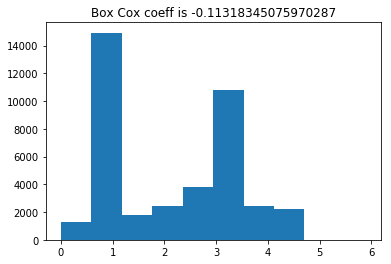

In [15]:
box_cox_len, _ = stats.boxcox(clean_df['Lenght of sample'])
plt.hist(box_cox_len)
plt.title('Box Cox coeff is {}'.format(_))

Картина достаточно схожая

In [16]:
import plotly.express as px
px.scatter(clean_df, x="Median sample", y="Lenght of sample",marginal_y="violin")

In [17]:
px.scatter(clean_df, x="Median sample", y="Value",marginal_y="violin")

Распределение по количеству замеров в разные часы суток выглядит крайне логично, а вот медианное явно указывает на пару инетресных ночей у пользователя.

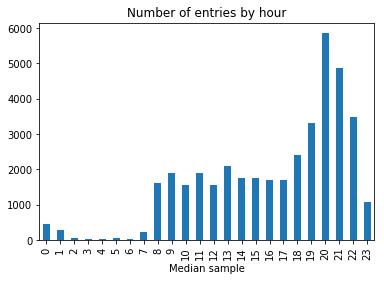

In [18]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.hour).count().plot(kind="bar",title='Number of entries by hour')

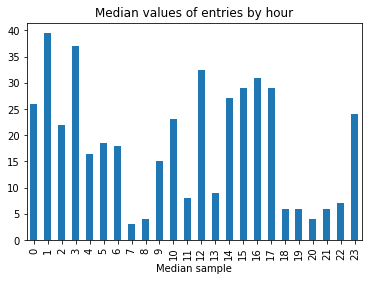

In [19]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.hour).median().plot(kind="bar",title='Median values of entries by hour')

По дням недели и дням месяца ничего сразу не бросается в глаза.

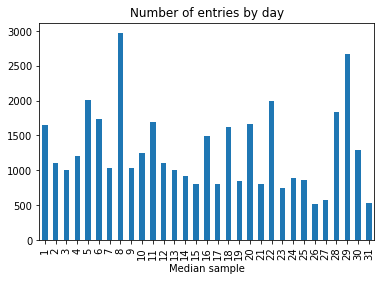

In [20]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.day).count().plot(kind="bar",title='Number of entries by day')

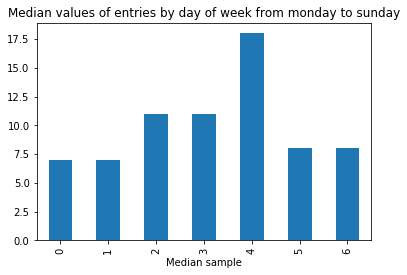

In [21]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.weekday).median().plot(kind="bar",title='Median values of entries by day of week from monday to sunday')

Подготовка данных для facebook prophet, он требует определенного названия колонок и отсутствия значений о тайм зоне, использовать будем доверительный интервал шириной 99% выборки, чтобы поймать выбросы наверняка, дневная сезонность 15 для большей гибкости из-за формата данных где изменения происходят по n раз в сутки. 

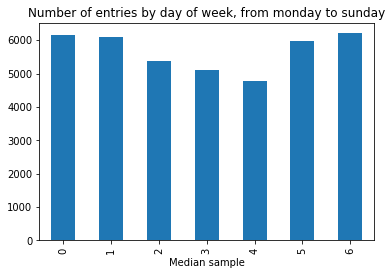

In [22]:
clean_df['Value'].groupby(clean_df['Median sample'].dt.weekday).count().plot(kind="bar",title='Number of entries by day of week, from monday to sunday')

In [23]:
clean_df.drop(['Time End Local Tz','Time Start Local Tz','Lenght of sample'],axis=1,inplace=True)

In [24]:
clean_df.columns = ['y','ds']

In [25]:
clean_df['ds'] = clean_df['ds'].dt.tz_localize(None)

In [26]:
m = Prophet(daily_seasonality = 15, yearly_seasonality = False, weekly_seasonality = True,
                growth = 'linear',
                seasonality_mode = 'multiplicative', 
                interval_width = 0.99,
                changepoint_prior_scale=0.05)

In [27]:
m.fit(clean_df)

C:\Users\steel\Anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [28]:
forecast = m.predict(clean_df)

Картинка кликабельная, позволит получше рассмотреть как prophet строит диапазон(его встроенный метод построения графика в plotly положил у меня jupyter, самописная функция на altair тоже очень сильно грузила систему из-за обилия точек. В финале будет интерактивный график, на стыке информативности и производительности.

In [29]:
from fbprophet.plot import plot
plot(m, forecast, figsize=(160, 80))

К концу лета человек стал определенно больше ходить, но тренд такое должен уловить.

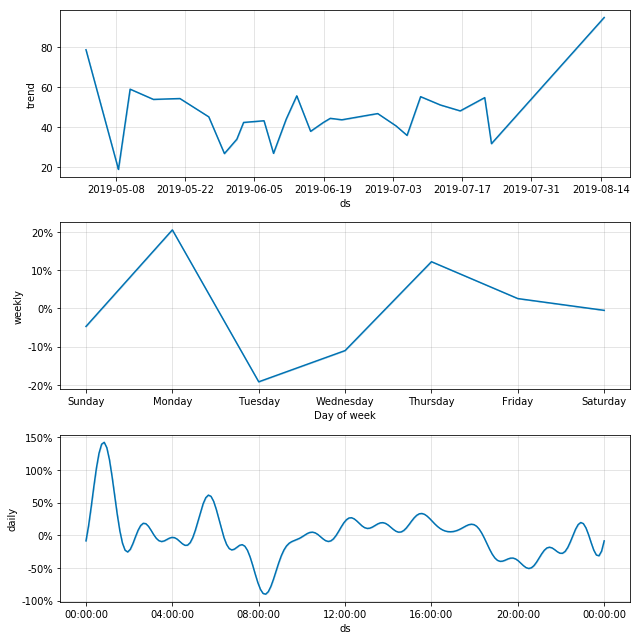

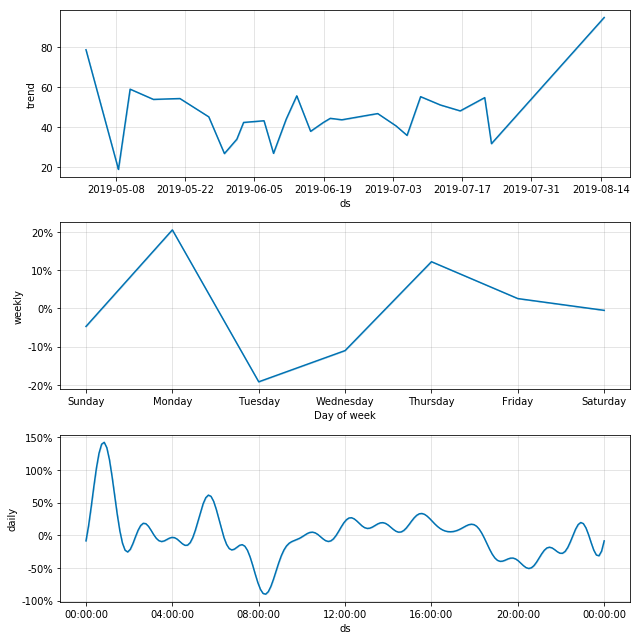

In [30]:
m.plot_components(forecast)

За аномалии берем всё, что выше верхней границы интервала в данной точке, и введем меру их "важности" - 
расстония до верхней границы (yhat_upper)

In [31]:
def detect_anomalies(forecast,original):
    forecasted = forecast[['ds','trend', 'yhat', 'yhat_lower', 'yhat_upper']].copy()
    forecasted['orig_value'] = original['y']
    forecasted['anomaly'] = 0
    forecasted.loc[original.y > forecasted['yhat_upper'], 'anomaly'] = 1
    forecasted.loc[original.y < forecasted['yhat_lower'], 'anomaly'] = -1

    forecasted['importance'] = 0
    forecasted.loc[forecasted['anomaly'] ==1, 'importance'] = \
        (original.y - forecasted['yhat_upper'])/forecasted['orig_value']
    forecasted.loc[forecasted['anomaly'] ==-1, 'importance'] = \
        (forecasted['yhat_lower'] - forecasted['orig_value'])/forecasted['orig_value']
    return forecasted

In [32]:
anomaly = detect_anomalies(forecast,clean_df)

Аномалии есть почти в каждом дне, поэтому важно будет их взвесить.

In [33]:
len(anomaly[anomaly['anomaly'] != 0]['ds'].dt.dayofyear.unique())

104

In [34]:
px.scatter(anomaly[anomaly['anomaly'] != 0], x="ds", y="importance",marginal_y="violin")

In [35]:
df_importance = anomaly[anomaly['anomaly'] != 0]['importance']

In [36]:
df_importance.describe([0.05,.25, .5, .75,0.95])

count    517.000000
mean       0.307025
std        0.184071
min        0.002060
5%         0.035766
25%        0.152327
50%        0.306491
75%        0.432680
95%        0.590645
max        0.964264
Name: importance, dtype: float64

Даже выбирая важные с точки зрения q1 аномалии их число не сильно уменьшается - они плюс/минус равномерно распределенены по дням.
Далее идут агрегатные функции и их визуализации.

In [37]:
len(anomaly[(anomaly['anomaly'] != 0) & (anomaly['importance'] > 0.15)]['ds'].dt.dayofyear.unique())

101

In [38]:
df_important_anomalies = anomaly[(anomaly['anomaly'] != 0)& (anomaly['importance'] > 0.15)].groupby(
    anomaly[(anomaly['anomaly'] != 0) & (anomaly['importance'] > 0.15
    )]['ds'].dt.dayofyear)['anomaly'].count()

In [39]:
df_important_anomalies.describe([0.05,.25, .5, .75,0.95])

count    101.000000
mean       3.871287
std        2.633110
min        1.000000
5%         1.000000
25%        2.000000
50%        3.000000
75%        6.000000
95%        8.000000
max       14.000000
Name: anomaly, dtype: float64

In [40]:
fig = go.Figure()
fig.add_trace(go.Box(y=df_important_anomalies .values,name='Important anomalies'))
fig.add_trace(go.Box(y=df_importance.values,name='Importance'))

In [41]:
original_by_days_sum = anomaly['orig_value'].groupby(anomaly['ds'].dt.dayofyear).sum()

In [42]:
original_by_days_sum.describe([0.05,.25, .5, .75,0.95])

count      104.000000
mean     15233.673077
std       5895.482163
min       5776.000000
5%        8237.900000
25%      11692.750000
50%      14508.500000
75%      17268.750000
95%      22614.000000
max      53253.000000
Name: orig_value, dtype: float64

In [43]:
fig = go.Figure()
fig.add_trace(go.Box(y=original_by_days_sum.values,boxpoints='all',name='Sum of original values by days'))

In [44]:
original_by_days_count = anomaly['orig_value'].groupby(anomaly['ds'].dt.dayofyear).count()

In [45]:
fig = go.Figure()
fig.add_trace(go.Box(y=original_by_days_count.values,boxpoints='all',name='Count of original values by days'))

In [46]:
fig = go.Figure()
_ = anomaly[(anomaly['anomaly'] != 0) & (anomaly['importance'] > 0.15)].groupby(anomaly['ds'].dt.dayofyear)['anomaly'].count()
fig.add_trace(go.Box(y=_.values,boxpoints='all',name='"Important" anomalies by days'))

На графиках выше видны выбросы по различным параметрам, попробуем собрать их вместе и проголосовать. 
Принимаем на вход прогноз prophet с добавленными к нему оригинальными значениями. Основная идея - выделить значащие аномалии, я выбрал для этого медиану их распределения, далее отсечь значащие аномалии по количеству, если в дне их больше чем q3 - однозначно день был необычным. Далее смотрим на количество записей в дне, если их крайне мало - то это точно аномалия (как например с 28 мая), и, конечно оценить суммарное количество шагов в день. 

In [47]:
def final_function(forecast):
    """Принимаем на вход предсказание prophet с оцененными аномалиями и столбцом оригинальных значений"""
    
    def get_important_anomalies_count(f_cast):
        """Группируем важность по дням, берем медиану, по ней отсекаем 
        незначительные аномалии и далее выбираем их, считаем количество в каждом дне,
        вычисляем первый и третий квантиль"""
        q2_c  = f_cast[f_cast['anomaly'] != 0]['importance'].quantile(0.5)
        res = f_cast[(f_cast['anomaly'] != 0)& (f_cast['importance'] > q2_c)].groupby(
        f_cast[(f_cast['anomaly'] != 0) & (f_cast['importance'] > q2_c
        )]['ds'].dt.dayofyear)['anomaly'].count()
        q1,q3 = res.quantile([0.25,0.75])
        return res,q1,q3
    
    def get_value_sum(f_cast):
        """Агрегатная функция количества шагов в день, вычисляем квантили"""
        res = f_cast['orig_value'].groupby(f_cast['ds'].dt.dayofyear).sum()
        q1,q3 = res.quantile([0.25,0.75])
        return res, q1, q3
    
    def get_value_count(f_cast):
        """Агрегатная функция количества записей в день, вычисляем квантили"""
        res = f_cast['orig_value'].groupby(f_cast['ds'].dt.dayofyear).count()
        q1,q3 = res.quantile([0.25,0.75])
        return res, q1, q3
    
    def anomaly_count(val, q1, q3):
        """Оцениваем количество аномалий по дням, границы наполовину интуитивные,
           полученные методом проб и ошибок"""
        if val >= q1 and val <= q3:
            return -1
        elif val > (q1+q3)/2:
            return 1
        else:
            return 0
        
        
    def lower_limit_values_sum(val, q1, q3):
        """Оцениваем количество шагов за день"""
        upper_fence = q3 + 1.5 * (q3 - q1)
        if val >= q1 and val <= q3:
            return 0
        elif val < q1 or val > q3:
            return 1
        elif val >= q3 and val <= upper_fence:
            return -1
        
        
    def lower_limit_values_count(val, q1, q3):
        """Оцениваем количество записей за день"""
        upper_fence = q3 + 1.5 * (q3 - q1)
        if val < q1 or val > upper_fence:
            return 1
        elif val > q3 and val <= upper_fence:
            return -1
        else:
            return 0
    
        
    def voting_function(series1, series2, series3):
        """Голосуем, каких значений больше - то и принимаем. Случай, когда все значения 
        разные учтен - я считаю, что оценка аномалий наиболее весомый признак"""
        res = []
        for val_1, val_2, val_3 in zip(series1,series2,series3):
            _ = [val_1,val_2,val_3]
            res.append(max(_, key=_.count))
        return res
    
    anomaly_grouped = forecast.groupby(forecast['ds'].dt.dayofyear).count()
    anomaly_grouped['anomaly_important'], q1_anom, q3_anom = get_important_anomalies_count(forecast)
    value_sum, q1_sum, q3_sum = get_value_sum(forecast)
    value_count, q1_count, q3_count = get_value_count(forecast)
    
        
    
    anomaly_grouped['uncertanty_by_anomalies'] =\
    anomaly_grouped['anomaly_important'].apply(anomaly_count,args=(q1_anom,q3_anom))
    anomaly_grouped['uncertanty_by_value_sum'] = value_sum.apply(lower_limit_values_sum,args=(q1_sum,q3_sum))
    anomaly_grouped['uncertanty_by_value_count'] =\
    value_count.apply(lower_limit_values_count,args=(q1_count,q3_count))
    anomaly_grouped['uncertanty_voted'] = voting_function(anomaly_grouped['uncertanty_by_anomalies'],
                                                          anomaly_grouped['uncertanty_by_value_sum'],
                                                          anomaly_grouped['uncertanty_by_value_count'])
    return anomaly_grouped

In [48]:
almost = final_function(anomaly)

Визуализируем

In [50]:
final = clean_df.copy()
final['anomaly'] = final['ds'].dt.dayofyear.map(almost['uncertanty_voted'].to_dict())

In [51]:
final['anomaly'].value_counts()

-1    15015
 1    12984
 0    11672
Name: anomaly, dtype: int64

График интерактивный и не особо сильно грузит систему, если добавлять еще элементы - появляются проблемы. Здесь 1 - это необычный день, 0 - обычный, -1 - неопределеннный. Синяя линия - верхняя граница доверительного интервала прогноза prophet.

In [52]:
fig = px.scatter(final, x="ds", y="y",color="anomaly",color_continuous_scale=px.colors.sequential.Inferno_r)
fig.add_trace(go.Scatter(x = final.ds, y = anomaly.yhat_upper,connectgaps=True,
                         name="Prophet upper boundary", line=dict(color='royalblue', width=4)))
fig.update_layout(legend_orientation="h")

Финальный результат в виде csv файла, размеченного по дням. Если кто-то дойдет до сюда, то очень хотел бы попросить прислать вашу версию разметки - крайне интересно сравнить со своей. И да, выбрасываем NaN и считаем их очевидной аномалией. 
Данный метод был выбран мною в силу его крайне наглядной визуализации и интерпретируемости результата, помимо этого я пробовал кластеризовать данные, но при росте числа фич визуализация становится затруднительна (особенно если использовать time lag, т.е смещенные значения из будещего как фичу). Аналогично добавление регрессоров к prophet уводило его сильно в сторону переобучения, что тоже негативно сказалось на результатах, и, в связи с этим, я остановился на таком подходе. Спасибо за внимание.

In [53]:
result = final.resample('D', on='ds').mean().replace(np.NaN, 1).drop('y',axis=1)

In [54]:
#result.to_csv('result.csv')